<a href="https://colab.research.google.com/github/RodeTavera/KOF/blob/main/Mapas%20de%20INEGI%20y%20pre-procesamiento.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CREACIÓN DE LA BASE DE DATOS

## Cargando pyspark y google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install pyspark

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 310.8/310.8 MB 4.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyspark: filename=pyspark-3.4.0-py2.py3-none-any.whl size=311317145 sha256=04b58763512aed45e388e00bc023dced1ba2a73ce45c0237944bc9ca00d8386e
  Stored in directory: /root/.cache/pip/wheels/9f/34/a4/159aa12d0a510d5ff7c8f0220abbea42e5d81ecf588c4fd884
Successfully built pyspark


In [ ]:
from pyspark.sql import SparkSession
spark = SparkSession.builder.master("local[*]").getOrCreate()
spark=SparkSession.builder.appName('sol').getOrCreate()

In [ ]:
ventas_sp=spark.read.option("header",True).csv('/content/drive/MyDrive/ventas.csv')

In [ ]:
ventas_sp.columns

['_c0',
 'KUNNR',
 'MATNR',
 'KUNNR_MATNR',
 'CALENDAR_DAY',
 'ANIO',
 'MES',
 'YEAR_MONTH',
 'WEEK_OF_YEAR',
 'DAY_OF_YEAR',
 'DAY_OF_WEEK',
 'DAY_OF_MONTH',
 'CU',
 'INGRESOBRUTO',
 'VOL_ING_CIMPTOS',
 'CF',
 'RM1',
 'SUBCANAL',
 'TIPO_CANAL',
 'CANAL',
 'MVGR2',
 'CATEGORIA',
 'TIPO_CONSUMO',
 'RETORNABILIDAD',
 'GEC',
 'CLUSTERANALYTICS',
 'BZIRK',
 'RM2',
 'VPTYPT']

In [ ]:
#prueba=ventas_sp.filter(ventas_sp.KUNNR_MATNR  == "1300009047-000000000000098253")

In [ ]:
#prueba.show(10000)

+--------+----------+------------------+--------------------+------------+----+----+----------+------------+-----------+-----------+------------+-------+-------------------+-------------------+----+--------------+--------+--------------------+--------------------+-----+---------+---------------+--------------+---+-------------------+------+--------------------+-------------+
|     _c0|     KUNNR|             MATNR|         KUNNR_MATNR|CALENDAR_DAY|ANIO| MES|YEAR_MONTH|WEEK_OF_YEAR|DAY_OF_YEAR|DAY_OF_WEEK|DAY_OF_MONTH|     CU|       INGRESOBRUTO|    VOL_ING_CIMPTOS|  CF|           RM1|SUBCANAL|          TIPO_CANAL|               CANAL|MVGR2|CATEGORIA|   TIPO_CONSUMO|RETORNABILIDAD|GEC|   CLUSTERANALYTICS| BZIRK|                 RM2|       VPTYPT|
+--------+----------+------------------+--------------------+------------+----+----+----------+------------+-----------+-----------+------------+-------+-------------------+-------------------+----+--------------+--------+--------------------+-

In [ ]:
clientes_sp=spark.read.option("header",True).csv('/content/drive/MyDrive/clientes.csv')

In [ ]:
codprod_sp=spark.read.option("header",True).csv('/content/drive/MyDrive/codprod.csv')

In [ ]:
materiales_sp=spark.read.option("header",True).csv('/content/drive/MyDrive/materiales.csv')

In [ ]:
ventas_sp.dtypes

[('_c0', 'string'),
 ('KUNNR', 'string'),
 ('MATNR', 'string'),
 ('KUNNR_MATNR', 'string'),
 ('CALENDAR_DAY', 'string'),
 ('ANIO', 'string'),
 ('MES', 'string'),
 ('YEAR_MONTH', 'string'),
 ('WEEK_OF_YEAR', 'string'),
 ('DAY_OF_YEAR', 'string'),
 ('DAY_OF_WEEK', 'string'),
 ('DAY_OF_MONTH', 'string'),
 ('CU', 'string'),
 ('INGRESOBRUTO', 'string'),
 ('VOL_ING_CIMPTOS', 'string'),
 ('CF', 'string'),
 ('RM1', 'string'),
 ('SUBCANAL', 'string'),
 ('TIPO_CANAL', 'string'),
 ('CANAL', 'string'),
 ('MVGR2', 'string'),
 ('CATEGORIA', 'string'),
 ('TIPO_CONSUMO', 'string'),
 ('RETORNABILIDAD', 'string'),
 ('GEC', 'string'),
 ('CLUSTERANALYTICS', 'string'),
 ('BZIRK', 'string'),
 ('RM2', 'string'),
 ('VPTYPT', 'string')]

In [ ]:
#clientes_sp2=clientes_sp

In [ ]:
#clientes_sp2=clientes_sp2.withColumnRenamed('KUNNR','KUNNR2')

In [ ]:
#Borrame=ventas_sp.join(clientes_sp2,ventas_sp.KUNNR==clientes_sp2.KUNNR2,"inner")

In [ ]:
#Borrame.count()

16494419

In [ ]:
#Borrame.createOrReplaceTempView('borrame2')

In [ ]:
#query="""
#SELECT KUNNR, COUNT(*) AS N
#FROM borrame2
#GROUP BY KUNNR;"""



In [ ]:
#print(spark.catalog.listTables())

[Table(name='borrame2', catalog=None, namespace=[], description=None, tableType='TEMPORARY', isTemporary=True)]


In [ ]:
#Borrame2=spark.sql(query)

In [ ]:
#Borrame2.count()

17437

In [ ]:
#Borrame2.columns

['KUNNR', 'N']

In [ ]:
#from pyspark.sql.functions import sum
#Borrame2.select(sum(Borrame2.N)).show()

+--------+
|  sum(N)|
+--------+
|16494419|
+--------+



In [ ]:
#Borrame2=Borrame.groupBy('KUNNR').count()

In [ ]:
#Borrame2

DataFrame[KUNNR: string, count: bigint]

In [ ]:
ventas_sp.createOrReplaceTempView('ventas')

In [ ]:
clientes_sp.columns

['_c0',
 'KUNNR',
 'BZIRK',
 'ZZCRMA_LONG',
 'ZZCRMA_LAT',
 'STREET',
 'STR_SUPPL3',
 'CITY1',
 'POST_CODE1',
 'ZCAL_RM1',
 'ZCAL_RM2']

In [ ]:
from pyspark.sql.types import IntegerType, DoubleType, BooleanType, DateType, NumericType
ventas_sp=ventas_sp.withColumn('CU',ventas_sp.CU.cast(DoubleType()))
ventas_sp=ventas_sp.withColumn('INGRESOBRUTO',ventas_sp.INGRESOBRUTO.cast(DoubleType()))
ventas_sp=ventas_sp.withColumn('VOL_ING_CIMPTOS',ventas_sp.VOL_ING_CIMPTOS.cast(DoubleType()))
ventas_sp=ventas_sp.withColumn('CF',ventas_sp.CF.cast(DoubleType()))
ventas_sp=ventas_sp.withColumn('MES',ventas_sp.MES.cast(DoubleType()))
clientes_sp=clientes_sp.withColumn('ZZCRMA_LONG',clientes_sp.ZZCRMA_LONG.cast(DoubleType()))
clientes_sp=clientes_sp.withColumn('ZZCRMA_LAT',clientes_sp.ZZCRMA_LAT.cast(DoubleType()))

In [ ]:
ventas_sp.createOrReplaceTempView('ventas')
clientes_sp.createOrReplaceTempView('clientes')
codprod_sp.createOrReplaceTempView('codprod')
materiales_sp.createOrReplaceTempView('materiales')



In [ ]:
pip install pyspark_dist_explore

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from pyspark_dist_explore import Histogram, hist, distplot, pandas_histogram

In [ ]:
from pyspark.sql.functions import col

In [ ]:
CU=ventas_sp.select('CU')

In [ ]:
CU.columns

['CU']

(array([1.000000e+00, 0.000000e+00, 1.000000e+00, 6.000000e+00,
        5.000000e+00, 2.000000e+00, 1.000000e+00, 1.000000e+00,
        7.000000e+00, 4.000000e+00, 7.000000e+00, 1.000000e+01,
        1.000000e+01, 1.800000e+01, 3.400000e+01, 3.144197e+06,
        3.614746e+06, 1.859093e+06, 2.618338e+06, 2.446694e+06,
        5.035560e+05, 7.770500e+05, 2.136430e+05, 8.205200e+04,
        8.608820e+05, 4.926700e+04, 1.008530e+05, 1.269770e+05,
        2.513500e+04, 3.572860e+05]),
 array([-10.        ,  -9.33333333,  -8.66666667,  -8.        ,
         -7.33333333,  -6.66666667,  -6.        ,  -5.33333333,
         -4.66666667,  -4.        ,  -3.33333333,  -2.66666667,
         -2.        ,  -1.33333333,  -0.66666667,   0.        ,
          0.66666667,   1.33333333,   2.        ,   2.66666667,
          3.33333333,   4.        ,   4.66666667,   5.33333333,
          6.        ,   6.66666667,   7.33333333,   8.        ,
          8.66666667,   9.33333333,  10.        ]),
 <BarContainer

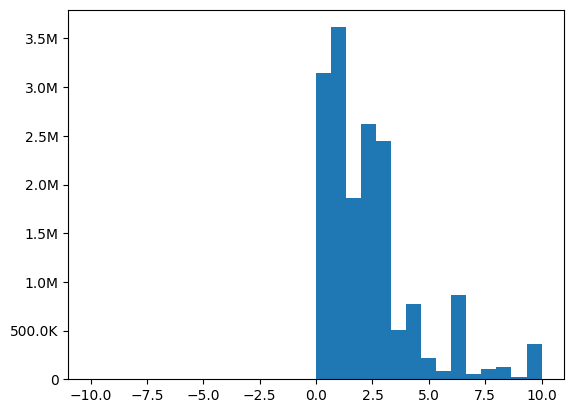

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
fig, ax = plt.subplots()
hist(ax,CU,bins=30,range=(-10,10))

In [ ]:
query="""SELECT 
    min(CU),
    min(CF),
    min(INGRESOBRUTO),
    min(VOL_ING_CIMPTOS)
FROM ventas
UNION
SELECT 
    max(CU),
    max(CF),
    max(INGRESOBRUTO),
    max(VOL_ING_CIMPTOS)
from ventas"""

In [ ]:
A=spark.sql(query)

In [ ]:
A=A.toPandas()

In [ ]:
A

,min(CU),min(CF),min(INGRESOBRUTO),min(VOL_ING_CIMPTOS)
0,-570.6117,-180.0,-8.679146e+05,-7.892930e+05
1,14930.0525,12040.0,1.406617e+06,1.279196e+06


In [ ]:
query="""
SELECT *
FROM ventas
WHERE CU < 0
"""

In [ ]:
Negativos=spark.sql(query)

In [ ]:
Negativos.columns

['_c0',
 'KUNNR',
 'MATNR',
 'KUNNR_MATNR',
 'CALENDAR_DAY',
 'ANIO',
 'MES',
 'YEAR_MONTH',
 'WEEK_OF_YEAR',
 'DAY_OF_YEAR',
 'DAY_OF_WEEK',
 'DAY_OF_MONTH',
 'CU',
 'INGRESOBRUTO',
 'VOL_ING_CIMPTOS',
 'CF',
 'RM1',
 'SUBCANAL',
 'TIPO_CANAL',
 'CANAL',
 'MVGR2',
 'CATEGORIA',
 'TIPO_CONSUMO',
 'RETORNABILIDAD',
 'GEC',
 'CLUSTERANALYTICS',
 'BZIRK',
 'RM2',
 'VPTYPT']

In [ ]:
# Using sum() function
from pyspark.sql.functions import sum
Negativos.select(sum(Negativos.CU)).show()

+-------------------+
|            sum(CU)|
+-------------------+
|-1129.8526999999995|
+-------------------+



In [ ]:
Negativos.show(truncate=False)

+-------+----------+------------------+-----------------------------+------------+----+----+----------+------------+-----------+-----------+------------+-------+-------------------+-------------------+----+--------------+------------------------+--------------------------+--------------------------------------+-----+-----------------------------+---------------+--------------+-----------+--------------------+------+--------------------+---------------+
|_c0    |KUNNR     |MATNR             |KUNNR_MATNR                  |CALENDAR_DAY|ANIO|MES |YEAR_MONTH|WEEK_OF_YEAR|DAY_OF_YEAR|DAY_OF_WEEK|DAY_OF_MONTH|CU     |INGRESOBRUTO       |VOL_ING_CIMPTOS    |CF  |RM1           |SUBCANAL                |TIPO_CANAL                |CANAL                                 |MVGR2|CATEGORIA                    |TIPO_CONSUMO   |RETORNABILIDAD|GEC        |CLUSTERANALYTICS    |BZIRK |RM2                 |VPTYPT         |
+-------+----------+------------------+-----------------------------+------------+----

In [ ]:
Negativos.count()

121

In [ ]:
query="""
SELECT *
FROM ventas
WHERE CU > 0
"""

In [ ]:
ventas2_sp=spark.sql(query)

In [ ]:
ventas2_sp.createOrReplaceTempView('ventas2')

In [ ]:
print(spark.catalog.listTables())

[Table(name='base_sp', catalog=None, namespace=[], description=None, tableType='TEMPORARY', isTemporary=True), Table(name='clientes', catalog=None, namespace=[], description=None, tableType='TEMPORARY', isTemporary=True), Table(name='codprod', catalog=None, namespace=[], description=None, tableType='TEMPORARY', isTemporary=True), Table(name='materiales', catalog=None, namespace=[], description=None, tableType='TEMPORARY', isTemporary=True), Table(name='ventas', catalog=None, namespace=[], description=None, tableType='TEMPORARY', isTemporary=True), Table(name='ventas2', catalog=None, namespace=[], description=None, tableType='TEMPORARY', isTemporary=True)]


In [ ]:
ventas_sp.createOrReplaceTempView('ventas')

In [ ]:
codprod_sp.columns

['_c0', 'MATNR2', 'MARCA', 'TAMANIO', 'EMPAQUE', 'LLAVE1']

In [ ]:
codprod_sp=codprod_sp.withColumnRenamed('MATNR','MATNR2')

In [ ]:
Base_sp=ventas2_sp.join(codprod_sp,ventas2_sp.MATNR==codprod_sp.MATNR2,"leftouter")

In [ ]:
Base_sp.count()

ERROR:root:KeyboardInterrupt while sending command.
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/py4j/java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
  File "/usr/local/lib/python3.9/dist-packages/py4j/clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/usr/lib/python3.9/socket.py", line 704, in readinto
    return self._sock.recv_into(b)
KeyboardInterrupt


KeyboardInterrupt: ignored

In [ ]:
ventas_sp.count()

17782874

In [ ]:
Base_sp.columns

['_c0',
 'KUNNR',
 'MATNR',
 'KUNNR_MATNR',
 'CALENDAR_DAY',
 'ANIO',
 'MES',
 'YEAR_MONTH',
 'WEEK_OF_YEAR',
 'DAY_OF_YEAR',
 'DAY_OF_WEEK',
 'DAY_OF_MONTH',
 'CU',
 'INGRESOBRUTO',
 'VOL_ING_CIMPTOS',
 'CF',
 'RM1',
 'SUBCANAL',
 'TIPO_CANAL',
 'CANAL',
 'MVGR2',
 'CATEGORIA',
 'TIPO_CONSUMO',
 'RETORNABILIDAD',
 'GEC',
 'CLUSTERANALYTICS',
 'BZIRK',
 'RM2',
 'VPTYPT',
 '_c0',
 'MATNR2',
 'MARCA',
 'TAMANIO',
 'EMPAQUE',
 'LLAVE1']

In [ ]:
Base_sp.show()

+---+----------+------------------+--------------------+------------+----+----+----------+------------+-----------+-----------+------------+-------+------------------+------------------+---+--------------+--------------------+--------------------+--------------------+-----+--------------------+---------------+--------------+-----------+--------------------+------+--------------------+---------------+----+------------------+----------+--------------------+-------+--------------------+
|_c0|     KUNNR|             MATNR|         KUNNR_MATNR|CALENDAR_DAY|ANIO| MES|YEAR_MONTH|WEEK_OF_YEAR|DAY_OF_YEAR|DAY_OF_WEEK|DAY_OF_MONTH|     CU|      INGRESOBRUTO|   VOL_ING_CIMPTOS| CF|           RM1|            SUBCANAL|          TIPO_CANAL|               CANAL|MVGR2|           CATEGORIA|   TIPO_CONSUMO|RETORNABILIDAD|        GEC|    CLUSTERANALYTICS| BZIRK|                 RM2|         VPTYPT| _c0|            MATNR2|     MARCA|             TAMANIO|EMPAQUE|              LLAVE1|
+---+----------+------

In [ ]:
Base_sp.createOrReplaceTempView('base_sp')

In [ ]:
query="""
SELECT SUM(CU)
FROM base_sp
"""

In [ ]:
a=spark.sql(query)

In [ ]:
a.show()

+------------------+
|           sum(CU)|
+------------------+
|8.40636973080293E7|
+------------------+



In [ ]:
basecompleta=Base_sp.groupBy('KUNNR').pivot('LLAVE1').sum('CU')

In [ ]:
basecompleta.show()

+----------+------------------+-------------------------------------+------------------------+---------------------------+---------------------------------------+-------------------------------------+-------------------------------------+-----------------------------------+--------------------------------------+--------------------------------------+---------------------------------------------------+---------------------------------+-------------------------------------+----------------------------------------+------------------------------------------+------------------------------------------------+-----------------------------------+---------------------------------+----------------------------------+--------------------------------------+--------------------------------------+--------------------------------------+---------------------------------------------+----------------------------------------+--------------------------------------+--------------------------------------+----

In [ ]:
basecompleta=basecompleta.withColumnRenamed('null','Otros')

In [ ]:
basecompleta.columns

['KUNNR',
 'Otros',
 'ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR',
 'ADES_946 ml_TETRAPACK_NR',
 'AGUA CIEL_1.2 Litros_PET_NR',
 'AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR',
 'AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR',
 'AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR',
 'AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR',
 'AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR',
 'AGUA CIEL_50.7 Onz / 1.5 LITROS_PET_NR',
 'AGUA CIEL_676.3 Onz / 20 LITROS_GARRAFÓN_RETORNABLE',
 'AMEYAL_67.6 Onz / 2 LITROS_PET_NR',
 'BEYONDKIDS_8.5 Onz / 250 ML=CC_PET_NR',
 'CC C/CAFE_7.9 Onz / 235ml=CC_ALUMINIO_NR',
 'CCLIGHT_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
 'CCLIGHT_12 Onz / 355/354 ML=CC_VIDRIO_RETORNABLE',
 'CCLIGHT_20.3 Onz / 600 ML=CC_PET_NR',
 'CCLIGHT_33.8 Onz / 1 LITRO_PET_NR',
 'CCLIGHT_67.6 Onz / 2 LITROS_PET_NR',
 'CCLIGHT_7.9 Onz / 235ml=CC_ALUMINIO_NR',
 'CCS/AZUCAR_10.1 Onz / 300 ML=CC_PET_NR',
 'CCS/AZUCAR_101.4 Onz / 3 LITROS_PET_NR',
 'CCS/AZUCAR_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
 'CCS/AZUCAR_12 Onz / 355/354 ML=CC_PET_NR',
 

In [ ]:
basecompleta=basecompleta.na.fill(value=0)

In [ ]:
basecompleta_pd=basecompleta.toPandas()

In [ ]:
basecompleta_pd.dtypes

KUNNR                                      object
Otros                                     float64
ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR     float64
ADES_946 ml_TETRAPACK_NR                  float64
AGUA CIEL_1.2 Litros_PET_NR               float64
                                           ...   
TOPOCHI_50.7 Onz / 1.5 LITROS_PET_NR      float64
VALLE PULP_13.5 Onz / 400 ML=CC_PET_NR    float64
VITAMIN WA_16.9 Onz / 500 ML=CC_PET_NR    float64
YOLI_20.3 Onz / 600 ML=CC_PET_NR          float64
YOLI_67.6 Onz / 2 LITROS_PET_NR           float64
Length: 166, dtype: object

In [ ]:
basecompleta_pd.iloc[:,1:].sum().sum()

84063697.3082

In [ ]:
basecompleta.show()

+----------+------------------+-------------------------------------+------------------------+---------------------------+---------------------------------------+-------------------------------------+-------------------------------------+-----------------------------------+--------------------------------------+--------------------------------------+---------------------------------------------------+---------------------------------+-------------------------------------+----------------------------------------+------------------------------------------+------------------------------------------------+-----------------------------------+---------------------------------+----------------------------------+--------------------------------------+--------------------------------------+--------------------------------------+---------------------------------------------+----------------------------------------+--------------------------------------+--------------------------------------+----

In [ ]:
basecompleta=basecompleta.withColumnRenamed('null','Otros')

In [ ]:
basecompleta.show()

+----------+------------------+-------------------------------------+------------------------+---------------------------+---------------------------------------+-------------------------------------+-------------------------------------+-----------------------------------+--------------------------------------+--------------------------------------+---------------------------------------------------+---------------------------------+-------------------------------------+----------------------------------------+------------------------------------------+------------------------------------------------+-----------------------------------+---------------------------------+----------------------------------+--------------------------------------+--------------------------------------+--------------------------------------+---------------------------------------------+----------------------------------------+--------------------------------------+--------------------------------------+----

In [ ]:
basecompleta=basecompleta.na.fill(value=0)

In [ ]:
basecompleta.count()

24789

In [ ]:
len(basecompleta.columns)

169

In [ ]:
clientes_sp.columns

['_c0',
 'KUNNR',
 'BZIRK',
 'ZZCRMA_LONG',
 'ZZCRMA_LAT',
 'STREET',
 'STR_SUPPL3',
 'CITY1',
 'POST_CODE1',
 'ZCAL_RM1',
 'ZCAL_RM2']

In [ ]:
clientes_sp=clientes_sp.withColumnRenamed('KUNNR','KUNNR2')

In [ ]:
basecompleta=basecompleta.join(clientes_sp,basecompleta.KUNNR==clientes_sp.KUNNR2,'inner')

In [ ]:
products=basecompleta.columns

In [ ]:
products

['KUNNR',
 'Otros',
 'ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR',
 'ADES_946 ml_TETRAPACK_NR',
 'AGUA CIEL_1.2 Litros_PET_NR',
 'AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR',
 'AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR',
 'AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR',
 'AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR',
 'AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR',
 'AGUA CIEL_50.7 Onz / 1.5 LITROS_PET_NR',
 'AGUA CIEL_676.3 Onz / 20 LITROS_GARRAFÓN_RETORNABLE',
 'AMEYAL_67.6 Onz / 2 LITROS_PET_NR',
 'BEYONDKIDS_8.5 Onz / 250 ML=CC_PET_NR',
 'CC C/CAFE_7.9 Onz / 235ml=CC_ALUMINIO_NR',
 'CCLIGHT_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
 'CCLIGHT_12 Onz / 355/354 ML=CC_VIDRIO_RETORNABLE',
 'CCLIGHT_20.3 Onz / 600 ML=CC_PET_NR',
 'CCLIGHT_33.8 Onz / 1 LITRO_PET_NR',
 'CCLIGHT_67.6 Onz / 2 LITROS_PET_NR',
 'CCLIGHT_7.9 Onz / 235ml=CC_ALUMINIO_NR',
 'CCS/AZUCAR_10.1 Onz / 300 ML=CC_PET_NR',
 'CCS/AZUCAR_101.4 Onz / 3 LITROS_PET_NR',
 'CCS/AZUCAR_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
 'CCS/AZUCAR_12 Onz / 355/354 ML=CC_PET_NR',
 

In [ ]:
basecompleta.dtypes

[('KUNNR', 'string'),
 ('Otros', 'double'),
 ('ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR', 'double'),
 ('ADES_946 ml_TETRAPACK_NR', 'double'),
 ('AGUA CIEL_1.2 Litros_PET_NR', 'double'),
 ('AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR', 'double'),
 ('AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR', 'double'),
 ('AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR', 'double'),
 ('AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR', 'double'),
 ('AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR', 'double'),
 ('AGUA CIEL_50.7 Onz / 1.5 LITROS_PET_NR', 'double'),
 ('AGUA CIEL_676.3 Onz / 20 LITROS_GARRAFÓN_RETORNABLE', 'double'),
 ('AMEYAL_67.6 Onz / 2 LITROS_PET_NR', 'double'),
 ('BEYONDKIDS_8.5 Onz / 250 ML=CC_PET_NR', 'double'),
 ('CC C/CAFE_7.9 Onz / 235ml=CC_ALUMINIO_NR', 'double'),
 ('CCLIGHT_12 Onz / 355/354 ML=CC_ALUMINIO_NR', 'double'),
 ('CCLIGHT_12 Onz / 355/354 ML=CC_VIDRIO_RETORNABLE', 'double'),
 ('CCLIGHT_20.3 Onz / 600 ML=CC_PET_NR', 'double'),
 ('CCLIGHT_33.8 Onz / 1 LITRO_PET_NR', 'double'),
 ('CCLIGHT_67.6 Onz / 2 LITROS_PET_N

In [ ]:
products=basecompleta.columns
products=products[1:166] # Todos los productos que vende KOF

In [ ]:
products

['Otros',
 'ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR',
 'ADES_946 ml_TETRAPACK_NR',
 'AGUA CIEL_1.2 Litros_PET_NR',
 'AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR',
 'AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR',
 'AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR',
 'AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR',
 'AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR',
 'AGUA CIEL_50.7 Onz / 1.5 LITROS_PET_NR',
 'AGUA CIEL_676.3 Onz / 20 LITROS_GARRAFÓN_RETORNABLE',
 'AMEYAL_67.6 Onz / 2 LITROS_PET_NR',
 'BEYONDKIDS_8.5 Onz / 250 ML=CC_PET_NR',
 'CC C/CAFE_7.9 Onz / 235ml=CC_ALUMINIO_NR',
 'CCLIGHT_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
 'CCLIGHT_12 Onz / 355/354 ML=CC_VIDRIO_RETORNABLE',
 'CCLIGHT_20.3 Onz / 600 ML=CC_PET_NR',
 'CCLIGHT_33.8 Onz / 1 LITRO_PET_NR',
 'CCLIGHT_67.6 Onz / 2 LITROS_PET_NR',
 'CCLIGHT_7.9 Onz / 235ml=CC_ALUMINIO_NR',
 'CCS/AZUCAR_10.1 Onz / 300 ML=CC_PET_NR',
 'CCS/AZUCAR_101.4 Onz / 3 LITROS_PET_NR',
 'CCS/AZUCAR_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
 'CCS/AZUCAR_12 Onz / 355/354 ML=CC_PET_NR',
 'CCS/AZUCA

In [ ]:
basecompleta_pd=basecompleta.toPandas()

In [ ]:
Base=basecompleta_pd[products]

In [ ]:
Base.columns

Index(['Otros', 'ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR',
       'ADES_946 ml_TETRAPACK_NR', 'AGUA CIEL_1.2 Litros_PET_NR',
       'AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR',
       'AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR',
       'AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR',
       'AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR',
       'AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR',
       'AGUA CIEL_50.7 Onz / 1.5 LITROS_PET_NR',
       ...
       'SPRITE_7.9 Onz / 235ml=CC_VIDRIO_NR',
       'TOCHITWIST_20.3 Onz / 600 ML=CC_PET_NR',
       'TOPCHIC HS_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
       'TOPOCHI_12 Onz / 355/354 ML=CC_VIDRIO_NR',
       'TOPOCHI_20.3 Onz / 600 ML=CC_PET_NR',
       'TOPOCHI_50.7 Onz / 1.5 LITROS_PET_NR',
       'VALLE PULP_13.5 Onz / 400 ML=CC_PET_NR',
       'VITAMIN WA_16.9 Onz / 500 ML=CC_PET_NR',
       'YOLI_20.3 Onz / 600 ML=CC_PET_NR', 'YOLI_67.6 Onz / 2 LITROS_PET_NR'],
      dtype='object', length=165)

In [ ]:
(Base<0).sum().sum()

0

In [ ]:
Base.columns

Index(['ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR', 'ADES_946 ml_TETRAPACK_NR',
       'AGUA CIEL_1.2 Litros_PET_NR',
       'AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR',
       'AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR',
       'AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR',
       'AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR',
       'AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR',
       'AGUA CIEL_50.7 Onz / 1.5 LITROS_PET_NR',
       'AGUA CIEL_676.3 Onz / 20 LITROS_GARRAFÓN_RETORNABLE',
       ...
       'TOCHITWIST_20.3 Onz / 600 ML=CC_PET_NR',
       'TOPCHIC HS_12 Onz / 355/354 ML=CC_ALUMINIO_NR',
       'TOPOCHI_12 Onz / 355/354 ML=CC_VIDRIO_NR',
       'TOPOCHI_20.3 Onz / 600 ML=CC_PET_NR',
       'TOPOCHI_50.7 Onz / 1.5 LITROS_PET_NR',
       'VALLE PULP_13.5 Onz / 400 ML=CC_PET_NR',
       'VITAMIN WA_16.9 Onz / 500 ML=CC_PET_NR',
       'YOLI_20.3 Onz / 600 ML=CC_PET_NR', 'YOLI_67.6 Onz / 2 LITROS_PET_NR',
       '_c0'],
      dtype='object', length=165)

In [ ]:
basecompleta_pd['total']=basecompleta_pd.loc[:,products].sum(axis=1)

In [ ]:
basecompleta_pd

,KUNNR,Otros,ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR,ADES_946 ml_TETRAPACK_NR,AGUA CIEL_1.2 Litros_PET_NR,AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR,AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR,AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR,AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR,AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR,...,BZIRK,ZZCRMA_LONG,ZZCRMA_LAT,STREET,STR_SUPPL3,CITY1,POST_CODE1,ZCAL_RM1,ZCAL_RM2,total
0,0120095238,18114.992084,0.000000,0.000000,3794.002184,0.0,2191.743660,1961.336543,2685.608228,3138.804162,...,MR0297,-99.351910140000,19.359793770000,AV GALEANA,BARRIO SAN MARTIN,HUIXQUILUCAN,52760,HM Moderno,HM Proximidad,413235.123824
1,0120182523,4.443335,0.000000,0.000000,0.000000,0.0,0.000000,339.309218,347.388009,0.000000,...,MR0297,-99.641337700000,19.272716100000,WENCESLAO LABRA,VALLE VERDE,TOLUCA,50140,OP Tradicional,Comidas,12003.596804
2,0120208617,14232.357484,19.784959,219.096810,1374.153862,0.0,0.000000,135.691372,720.983617,3986.721741,...,MR0297,-99.348536700000,19.295604110000,CALLE CHINACO,ESTACIÓN MACLOVIO HERRERA,OCOYOACAC,52757,HM Tradicional,"Abts., Misc. y Minis",244446.795254
3,1300000099,62761.339446,0.000000,47.018563,595.810830,0.0,0.000000,64.630327,382.934689,0.000000,...,MR0297,-99.672180940000,19.299283130000,PROLG 18 DE MARZO,LA TERESONA,TOLUCA,50040,HM Tradicional,Otros HM,216603.630143
4,1300000106,57875.327094,0.000000,0.000000,255.693733,0.0,565.192213,129.260655,166.019153,502.500795,...,MR0297,-99.673296850000,19.299797480000,PROLG 18 DE MARZO,LA TERESONA,TOLUCA,50040,HM Tradicional,"Abts., Misc. y Minis",316581.891169
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17432,1420017708,17732.097788,21.408796,49.280625,166.019153,0.0,222.166750,32.315164,1015.907958,126.998593,...,MR0297,-99.719934550000,19.422720980000,SIN NOMBRE,MINA MEXICO,ALMOLOYA DE JUAREZ,50900,HM Tradicional,"Abts., Misc. y Minis",88856.060311
17433,1420019070,677715.373562,0.000000,0.000000,0.000000,0.0,0.000000,6334.579957,17774.955774,0.000000,...,MR0297,-99.734850000000,19.292220000000,AV. 16 DE SEPTIEMBRE,BARRIO DE SAN MIGUEL,ZINACANTEPEC,51350,OP Moderno,OP CI & OP KA,768052.421666
17434,1420019975,268397.041465,0.000000,0.000000,0.000000,0.0,0.000000,2718.270780,0.000000,0.000000,...,MR0297,-99.734110000000,19.289750000000,AVENIDA 16 DE SEPTIEMBRE,BARRIO DE SAN MIGUEL,ZINACANTEPEC,51350,OP Moderno,OP CI & OP KA,291649.465953
17435,1420021502,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,9721.386843,41826.768544,0.000000,...,MR0297,-99.622720000000,19.254067000000,PEDRO ASCENCIO,LA MICHOACANA,METEPEC,52166,OP Moderno,OP CI & OP KA,308007.167515


In [ ]:
basecompleta_pd=basecompleta.toPandas()

In [ ]:
basecompleta_pd.to_csv('/content/drive/MyDrive/basecompleta.csv')

In [ ]:
pip install geopandas shapely mapclassify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 33.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 47.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 40.5 MB/s eta 0:00:00


In [ ]:
import geopandas
import shapely
import matplotlib.pyplot as plt
from mapclassify import classify

In [ ]:
EdoMexMun=geopandas.read_file('/content/drive/MyDrive/MapasMexico/scince_2020/mex/cartografia/mex_municipal.shp')

In [ ]:
EdoMexMun

,CVEGEO,NOM_ENT,NOMGEO,POB1,POB2,POB2_R,POB4,POB4_R,POB5,POB5_R,...,POB121,POB121_R,POB122,POB122_R,POB123,POB123_R,POB124,POB124_R,OID,geometry
0,15001,México,Acambay de Ruíz Castañeda,67872.0,3782.0,5.6,3985.0,5.9,8241.0,12.1,...,632.0,0.9,480.0,0.7,269.0,0.4,240.0,0.4,1,"POLYGON ((2710519.763 897148.822, 2710518.168 ..."
1,15002,México,Acolman,171507.0,6123.0,3.6,7539.0,4.4,17097.0,10.0,...,1214.0,0.7,724.0,0.4,441.0,0.3,347.0,0.2,2,"POLYGON ((2821996.495 857457.876, 2822094.768 ..."
2,15003,México,Aculco,49266.0,2719.0,5.5,2807.0,5.7,5697.0,11.6,...,419.0,0.9,276.0,0.6,187.0,0.4,175.0,0.4,3,"POLYGON ((2710574.958 920075.574, 2710568.459 ..."
3,15004,México,Almoloya de Alquisiras,15333.0,948.0,6.2,850.0,5.5,1808.0,11.8,...,140.0,0.9,105.0,0.7,66.0,0.4,70.0,0.5,4,"MULTIPOLYGON (((2726597.297 755294.161, 272675..."
4,15005,México,Almoloya de Juárez,174587.0,9372.0,5.4,9853.0,5.6,20107.0,11.5,...,1055.0,0.6,670.0,0.4,384.0,0.2,268.0,0.2,5,"POLYGON ((2723843.901 838925.750, 2724308.189 ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,15121,México,Cuautitlán Izcalli,555163.0,18358.0,3.3,23152.0,4.2,46259.0,8.3,...,6641.0,1.2,3640.0,0.7,1818.0,0.3,1204.0,0.2,121,"POLYGON ((2793735.316 861614.363, 2793868.015 ..."
121,15122,México,Valle de Chalco Solidaridad,391731.0,19225.0,4.9,22244.0,5.7,41585.0,10.6,...,3109.0,0.8,1604.0,0.4,786.0,0.2,564.0,0.1,122,"POLYGON ((2819254.679 818634.797, 2819325.636 ..."
122,15123,México,Luvianos,28822.0,1933.0,6.7,1895.0,6.6,3843.0,13.3,...,349.0,1.2,280.0,1.0,199.0,0.7,163.0,0.6,123,"POLYGON ((2671505.086 787413.992, 2671508.336 ..."
123,15124,México,San José del Rincón,100082.0,7093.0,7.1,7134.0,7.1,13567.0,13.6,...,565.0,0.6,397.0,0.4,231.0,0.2,220.0,0.2,124,"POLYGON ((2701419.074 866415.072, 2701508.786 ..."


In [ ]:
EdoMexMun.explore()

In [ ]:
basecompleta_gpd=geopandas.GeoDataFrame(basecompleta_pd, geometry=geopandas.points_from_xy(basecompleta_pd.ZZCRMA_LONG,basecompleta_pd.ZZCRMA_LAT))

/usr/local/lib/python3.9/dist-packages/geopandas/geodataframe.py:1443: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)


In [ ]:
basecompleta_gpd

,KUNNR,Otros,ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR,ADES_946 ml_TETRAPACK_NR,AGUA CIEL_1.2 Litros_PET_NR,AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR,AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR,AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR,AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR,AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR,...,ZZCRMA_LONG,ZZCRMA_LAT,STREET,STR_SUPPL3,CITY1,POST_CODE1,ZCAL_RM1,ZCAL_RM2,total,geometry
0,0120095238,18114.992084,0.000000,0.000000,3794.002184,0.0,2191.743660,1961.336543,2685.608228,3138.804162,...,-99.351910140000,19.359793770000,AV GALEANA,BARRIO SAN MARTIN,HUIXQUILUCAN,52760,HM Moderno,HM Proximidad,413235.123824,POINT (-99.35191 19.35979)
1,0120182523,4.443335,0.000000,0.000000,0.000000,0.0,0.000000,339.309218,347.388009,0.000000,...,-99.641337700000,19.272716100000,WENCESLAO LABRA,VALLE VERDE,TOLUCA,50140,OP Tradicional,Comidas,12003.596804,POINT (-99.64134 19.27272)
2,0120208617,14232.357484,19.784959,219.096810,1374.153862,0.0,0.000000,135.691372,720.983617,3986.721741,...,-99.348536700000,19.295604110000,CALLE CHINACO,ESTACIÓN MACLOVIO HERRERA,OCOYOACAC,52757,HM Tradicional,"Abts., Misc. y Minis",244446.795254,POINT (-99.34854 19.29560)
3,1300000099,62761.339446,0.000000,47.018563,595.810830,0.0,0.000000,64.630327,382.934689,0.000000,...,-99.672180940000,19.299283130000,PROLG 18 DE MARZO,LA TERESONA,TOLUCA,50040,HM Tradicional,Otros HM,216603.630143,POINT (-99.67218 19.29928)
4,1300000106,57875.327094,0.000000,0.000000,255.693733,0.0,565.192213,129.260655,166.019153,502.500795,...,-99.673296850000,19.299797480000,PROLG 18 DE MARZO,LA TERESONA,TOLUCA,50040,HM Tradicional,"Abts., Misc. y Minis",316581.891169,POINT (-99.67330 19.29980)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17432,1420017708,17732.097788,21.408796,49.280625,166.019153,0.0,222.166750,32.315164,1015.907958,126.998593,...,-99.719934550000,19.422720980000,SIN NOMBRE,MINA MEXICO,ALMOLOYA DE JUAREZ,50900,HM Tradicional,"Abts., Misc. y Minis",88856.060311,POINT (-99.71993 19.42272)
17433,1420019070,677715.373562,0.000000,0.000000,0.000000,0.0,0.000000,6334.579957,17774.955774,0.000000,...,-99.734850000000,19.292220000000,AV. 16 DE SEPTIEMBRE,BARRIO DE SAN MIGUEL,ZINACANTEPEC,51350,OP Moderno,OP CI & OP KA,768052.421666,POINT (-99.73485 19.29222)
17434,1420019975,268397.041465,0.000000,0.000000,0.000000,0.0,0.000000,2718.270780,0.000000,0.000000,...,-99.734110000000,19.289750000000,AVENIDA 16 DE SEPTIEMBRE,BARRIO DE SAN MIGUEL,ZINACANTEPEC,51350,OP Moderno,OP CI & OP KA,291649.465953,POINT (-99.73411 19.28975)
17435,1420021502,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,9721.386843,41826.768544,0.000000,...,-99.622720000000,19.254067000000,PEDRO ASCENCIO,LA MICHOACANA,METEPEC,52166,OP Moderno,OP CI & OP KA,308007.167515,POINT (-99.62272 19.25407)


In [ ]:
m=basecompleta_gpd.explore(
    tooltip="Otros"
)

In [ ]:
m.save('/content/drive/MyDrive/MapaClientes.html')

<Axes: >

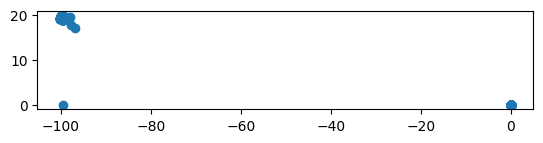

In [ ]:
basecompleta_gpd.plot()

In [ ]:
basecompleta_gpd['ZZCRMA_LAT']=basecompleta_gpd['ZZCRMA_LAT'].astype('double')

In [ ]:
basecompleta_gpd=basecompleta_gpd[basecompleta_gpd['ZZCRMA_LAT'] > 10]


<Axes: >

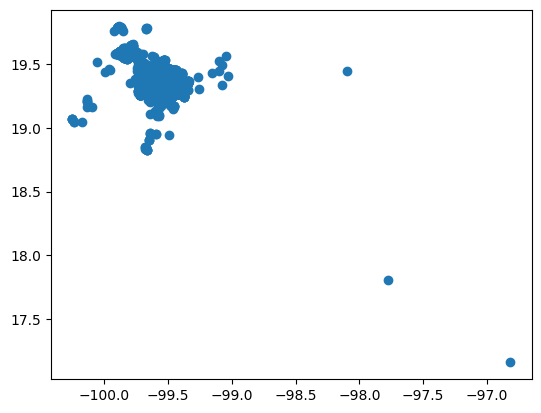

In [ ]:
basecompleta_gpd.plot()

In [ ]:
basecompleta_gpd.crs

In [ ]:
basecompleta_gpd=basecompleta_gpd.set_crs("EPSG:4326")

In [ ]:
basecompleta_gpd.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
basecompleta_gpd=basecompleta_gpd.to_crs(EdoMexMun.crs)

In [ ]:
EdoMexMun.crs

<Bound CRS: PROJCS["Mexico_ITRF2008_LCC",GEOGCS["Mexico_ITRF20 ...>
Name: Mexico_ITRF2008_LCC
Axis Info [cartesian]:
- [east]: Easting (Meter)
- [north]: Northing (Meter)
Area of Use:
- undefined
Coordinate Operation:
- name: Transformation from Mexico_ITRF2008 to WGS84
- method: Position Vector transformation (geog2D domain)
Datum: Mexico ITRF2008
- Ellipsoid: GRS_1980
- Prime Meridian: Greenwich
Source CRS: Mexico_ITRF2008_LCC

In [ ]:
basecompleta_pd.columns

Index(['KUNNR', 'Otros', 'ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR',
       'ADES_946 ml_TETRAPACK_NR', 'AGUA CIEL_1.2 Litros_PET_NR',
       'AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR',
       'AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR',
       'AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR',
       'AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR',
       'AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR',
       ...
       'BZIRK', 'ZZCRMA_LONG', 'ZZCRMA_LAT', 'STREET', 'STR_SUPPL3', 'CITY1',
       'POST_CODE1', 'ZCAL_RM1', 'ZCAL_RM2', 'total'],
      dtype='object', length=181)

<Axes: >

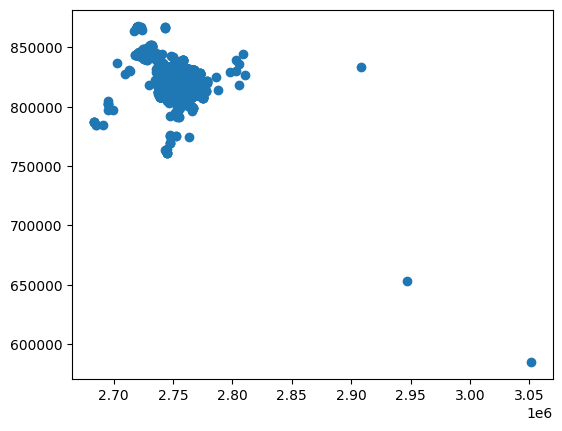

In [ ]:
basecompleta_gpd.plot()

<Axes: >

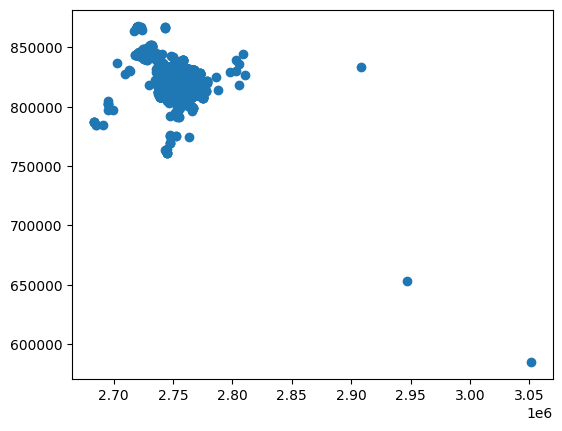

In [ ]:
basecompleta_gpd.plot()

In [ ]:
EdoMexAgeb=geopandas.read_file('/content/drive/MyDrive/MapasMexico/scince_2020/mex/cartografia/mex_ageb_urb.shp')

In [ ]:
pip install folium

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import folium

m = folium.Map(location=[19.432608, -99.133209], zoom_start=11) 

In [ ]:
m

In [ ]:
POB1=EdoMexAgeb.POB1

In [ ]:
POB1

0        309.0
1        596.0
2       3373.0
3        378.0
4        171.0
         ...  
4315    1020.0
4316    2686.0
4317    3209.0
4318    1573.0
4319    1028.0
Name: POB1, Length: 4320, dtype: float64

In [ ]:
EdoMexAgeb.CVEGEO

0       1500100010339
1       1500100010288
2       1500100010127
3       1500100010235
4       1500100010254
            ...      
4315    151250001004A
4316    1512500010016
4317    1512500010020
4318    1512500070054
4319    1512500070069
Name: CVEGEO, Length: 4320, dtype: object

In [ ]:
pip install branca

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import branca.colormap as cm

linear = cm.LinearColormap(["green", "yellow", "red"], vmin=min(POB1), vmax=max(POB1))

linear

In [ ]:
geojson=EdoMexAgeb.to_crs(epsg='4326').__geo_interface__ 

In [ ]:
folium.GeoJson(
    geojson,
    style_function=lambda feature: {
        'fillColor': linear(feature["properties"]["POB1"]),
        'color': "black",
        'weight': 0.5,
        'fillOpacity': 0.7
    },
    tooltip = folium.features.GeoJsonTooltip(["CVEGEO","POB1"])
).add_to(m) 

In [ ]:
m

In [ ]:
pip install branca

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


{'type': 'FeatureCollection',
 'features': [{'id': '0',
   'type': 'Feature',
   'properties': {'CVEGEO': '1500100010339',
    'POB1': 309.0,
    'POB2': 5.0,
    'POB2_R': 1.6,
    'POB4': 18.0,
    'POB4_R': 5.8,
    'POB5': 41.0,
    'POB5_R': 13.3,
    'POB6': 48.0,
    'POB6_R': 15.5,
    'POB7': 20.0,
    'POB7_R': 6.5,
    'POB8': 84.0,
    'POB8_R': 27.2,
    'POB9': 23.0,
    'POB9_R': 7.4,
    'POB10': 55.0,
    'POB10_R': 17.8,
    'POB11': 83.0,
    'POB11_R': 26.9,
    'POB12': 207.0,
    'POB12_R': 67.0,
    'POB13': 32.0,
    'POB13_R': 10.4,
    'POB14': 89.0,
    'POB14_R': 28.8,
    'POB15': 32.0,
    'POB15_R': 10.4,
    'POB17': 304.0,
    'POB17_R': 98.4,
    'POB18': 294.0,
    'POB18_R': 95.1,
    'POB19': 245.0,
    'POB19_R': 79.3,
    'POB20': 225.0,
    'POB20_R': 72.8,
    'POB21': 202.0,
    'POB21_R': 65.4,
    'POB22': 170.0,
    'POB22_R': 55.0,
    'POB23': 21.0,
    'POB23_R': 6.8,
    'POB24': 18.0,
    'POB24_R': 5.8,
    'POB25': 15.0,
    'POB25_R'

In [ ]:
import branca.colormap as cm

linear = cm.LinearColormap(["green", "yellow", "red"], vmin=min(indicador), vmax=max(indicador))

linear

In [ ]:
EdoMexAgeb_json

In [ ]:
folium.GeoJson(
    EdoMexAgeb_json
).add_to(m) 

In [ ]:
m

In [ ]:
EdoMexAgeb

,CVEGEO,POB1,POB2,POB2_R,POB4,POB4_R,POB5,POB5_R,POB6,POB6_R,...,POB121,POB121_R,POB122,POB122_R,POB123,POB123_R,POB124,POB124_R,OID,geometry
0,1500100010339,309.0,5.0,1.6,18.0,5.8,41.0,13.3,48.0,15.5,...,-6.0,-6.0,3.0,1.0,-6.0,-6.0,-6.0,-6.0,1,"POLYGON ((2724760.362 886442.542, 2724772.989 ..."
1,1500100010288,596.0,37.0,6.2,32.0,5.4,68.0,11.4,73.0,12.2,...,3.0,0.5,-6.0,-6.0,0.0,0.0,0.0,0.0,2,"POLYGON ((2724704.501 885107.501, 2724699.213 ..."
2,1500100010127,3373.0,180.0,5.3,175.0,5.2,323.0,9.6,352.0,10.4,...,41.0,1.2,23.0,0.7,4.0,0.1,11.0,0.3,3,"POLYGON ((2725014.737 886056.262, 2725029.237 ..."
3,1500100010235,378.0,19.0,5.0,20.0,5.3,45.0,11.9,46.0,12.2,...,-6.0,-6.0,-6.0,-6.0,-6.0,-6.0,0.0,0.0,4,"POLYGON ((2724581.913 884617.582, 2724516.498 ..."
4,1500100010254,171.0,7.0,4.1,7.0,4.1,22.0,12.9,23.0,13.5,...,-6.0,-6.0,0.0,0.0,0.0,0.0,-6.0,-6.0,5,"POLYGON ((2725794.811 885710.144, 2725786.999 ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4315,151250001004A,1020.0,51.0,5.0,64.0,6.3,108.0,10.6,130.0,12.7,...,13.0,1.3,-6.0,-6.0,-6.0,-6.0,0.0,0.0,4316,"POLYGON ((2808390.934 857912.251, 2808614.795 ..."
4316,1512500010016,2686.0,88.0,3.3,129.0,4.8,272.0,10.1,333.0,12.4,...,26.0,1.0,29.0,1.1,25.0,0.9,16.0,0.6,4317,"POLYGON ((2808318.468 857265.867, 2808312.961 ..."
4317,1512500010020,3209.0,144.0,4.5,177.0,5.5,376.0,11.7,451.0,14.1,...,23.0,0.7,10.0,0.3,9.0,0.3,7.0,0.2,4318,"POLYGON ((2807637.181 858200.578, 2807639.598 ..."
4318,1512500070054,1573.0,97.0,6.2,115.0,7.3,182.0,11.6,186.0,11.8,...,0.0,0.0,-6.0,-6.0,-6.0,-6.0,4.0,0.3,4319,"POLYGON ((2806574.677 856458.207, 2806484.183 ..."


In [ ]:
geopandas.sjoin(basecompleta_gpd,EdoMexAgeb)

,KUNNR,Otros,ADES_6.8 Onz / 200 ML=CC_TETRAPACK_NR,ADES_946 ml_TETRAPACK_NR,AGUA CIEL_1.2 Litros_PET_NR,AGUA CIEL_12 Onz / 355/354 ML=CC_PET_NR,AGUA CIEL_169.1 Onz / 5 LITROS_PET_NR,AGUA CIEL_20.3 Onz / 600 ML=CC_PET_NR,AGUA CIEL_33.8 Onz / 1 LITRO_PET_NR,AGUA CIEL_338.1 Onz / 10 LITROS_PET_NR,...,POB120_R,POB121,POB121_R,POB122,POB122_R,POB123,POB123_R,POB124,POB124_R,OID
0,0120095238,18114.992084,0.000000,0.000000,3794.002184,0.0,2191.743660,1961.336543,2685.608228,3138.804162,...,1.5,56.0,1.3,32.0,0.7,19.0,0.4,13.0,0.3,1388
753,1300022558,31702.613580,0.000000,55.501294,832.317434,0.0,0.000000,836.857715,978.341580,636.931876,...,1.5,56.0,1.3,32.0,0.7,19.0,0.4,13.0,0.3,1388
760,1300023568,8985.376675,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,1.5,56.0,1.3,32.0,0.7,19.0,0.4,13.0,0.3,1388
762,1300023602,32679.614081,0.000000,0.000000,1063.572824,0.0,276.375437,286.191168,583.288704,167.069396,...,1.5,56.0,1.3,32.0,0.7,19.0,0.4,13.0,0.3,1388
764,1300023616,40516.929937,110.792539,110.170472,2201.470525,0.0,562.283848,3657.761454,1568.295287,188.720556,...,1.5,56.0,1.3,32.0,0.7,19.0,0.4,13.0,0.3,1388
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17411,1400056310,251.153452,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,1.7,68.0,1.2,44.0,0.8,26.0,0.4,22.0,0.4,3105
17415,1400082675,5511.545054,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,1.0,33.0,0.9,18.0,0.5,27.0,0.8,23.0,0.7,3848
17417,1400082696,6848.584951,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.9,16.0,0.6,11.0,0.4,9.0,0.4,7.0,0.3,3819
17418,1400087006,2515.024558,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,1.1,42.0,0.6,25.0,0.4,22.0,0.3,20.0,0.3,3816


In [ ]:
Base_sp.columns

['_c0',
 'KUNNR',
 'MATNR',
 'KUNNR_MATNR',
 'CALENDAR_DAY',
 'ANIO',
 'MES',
 'YEAR_MONTH',
 'WEEK_OF_YEAR',
 'DAY_OF_YEAR',
 'DAY_OF_WEEK',
 'DAY_OF_MONTH',
 'CU',
 'INGRESOBRUTO',
 'VOL_ING_CIMPTOS',
 'CF',
 'RM1',
 'SUBCANAL',
 'TIPO_CANAL',
 'CANAL',
 'MVGR2',
 'CATEGORIA',
 'TIPO_CONSUMO',
 'RETORNABILIDAD',
 'GEC',
 'CLUSTERANALYTICS',
 'BZIRK',
 'RM2',
 'VPTYPT',
 '_c0',
 'MATNR2',
 'MARCA',
 'TAMANIO',
 'EMPAQUE',
 'LLAVE1']

In [ ]:
codprod_sp.show()

+---+------------------+----------+--------------------+--------+--------------------+
|_c0|            MATNR2|     MARCA|             TAMANIO| EMPAQUE|              LLAVE1|
+---+------------------+----------+--------------------+--------+--------------------+
|  0|000000000000001860|      YOLI|20.3 Onz / 600 ML=CC|     PET|YOLI_20.3 Onz / 6...|
|  1|000000000000097821|      FUZE|20.3 Onz / 600 ML=CC|     PET|FUZE_20.3 Onz / 6...|
|  2|000000000000099858|   MONSTER|  16 Onz / 473 ML=CC|ALUMINIO|MONSTER_16 Onz / ...|
|  3|000000000000003002|CCS/AZUCAR|10.1 Onz / 300 ML=CC|     PET|CCS/AZUCAR_10.1 O...|
|  4|000000000000098068|   DV FRUT|50.7 Onz / 1.5 LI...|     PET|DV FRUT_50.7 Onz ...|
|  5|000000000000099983|    MUNDET| 67.6 Onz / 2 LITROS|     PET|MUNDET_67.6 Onz /...|
|  6|000000000000000671|        CC|13.5 Onz / 400 ML=CC|     PET|CC_13.5 Onz / 400...|
|  7|000000000000099455|   DELVLLE| 8 Onz/236/237 ML=CC|     PET|DELVLLE_8 Onz/236...|
|  8|000000000000002584|        CC| 8.5 Onz

In [ ]:
ventas

In [ ]:
Base_sp.createOrReplaceTempView('base')

In [ ]:
query=""" SELECT 
SUM(INGRESOBRUTO)
FROM base
GROUP BY MATNR ;"""

In [ ]:
PRUEBA=spark.sql(query)

In [ ]:
PRUEBA=PRUEBA.toPandas()

In [ ]:
ventas_sp.dtypes

[('_c0', 'string'),
 ('KUNNR', 'string'),
 ('MATNR', 'string'),
 ('KUNNR_MATNR', 'string'),
 ('CALENDAR_DAY', 'string'),
 ('ANIO', 'string'),
 ('MES', 'double'),
 ('YEAR_MONTH', 'string'),
 ('WEEK_OF_YEAR', 'string'),
 ('DAY_OF_YEAR', 'string'),
 ('DAY_OF_WEEK', 'string'),
 ('DAY_OF_MONTH', 'string'),
 ('CU', 'double'),
 ('INGRESOBRUTO', 'double'),
 ('VOL_ING_CIMPTOS', 'double'),
 ('CF', 'double'),
 ('RM1', 'string'),
 ('SUBCANAL', 'string'),
 ('TIPO_CANAL', 'string'),
 ('CANAL', 'string'),
 ('MVGR2', 'string'),
 ('CATEGORIA', 'string'),
 ('TIPO_CONSUMO', 'string'),
 ('RETORNABILIDAD', 'string'),
 ('GEC', 'string'),
 ('CLUSTERANALYTICS', 'string'),
 ('BZIRK', 'string'),
 ('RM2', 'string'),
 ('VPTYPT', 'string')]

In [ ]:
df = ventas_sp.groupBy('KUNNR').pivot('CATEGORIA').sum('INGRESOBRUTO')

In [ ]:
df.show()

ERROR:root:KeyboardInterrupt while sending command.
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/py4j/java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
  File "/usr/local/lib/python3.9/dist-packages/py4j/clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/usr/lib/python3.9/socket.py", line 704, in readinto
    return self._sock.recv_into(b)
KeyboardInterrupt


KeyboardInterrupt: ignored

In [ ]:
df=df.na.fill(value=0)

In [ ]:
df.show()

+----------+-------+------------------+------------------+-----------------------------+---------------+--------------------------+---------------+--------------------------+------------------+-----------------------------+--------+-------------------+---------------+--------------------------+---------------+--------------------------+-----------+----------------------+---------------------------+--------------------------------------+-------------------+------------------------------+----------+---------------------+-------------------------+------------------------------------+--------------------------------+-------------------------------------------+----------+---------------------+----------+---------------------+-----+----------------+
|     KUNNR|null_CU|null_INGRESOBRUTO_|AGUA ADICIONADA_CU|AGUA ADICIONADA_INGRESOBRUTO_|AGUA CON GAS_CU|AGUA CON GAS_INGRESOBRUTO_|AGUA SIN GAS_CU|AGUA SIN GAS_INGRESOBRUTO_|BEBIDAS DE SOYA_CU|BEBIDAS DE SOYA_INGRESOBRUTO_|COLAS_CU|COLAS_INGRESOB

In [ ]:
df.count()

24789

In [ ]:
df=df.toPandas()

In [ ]:
df

,KUNNR,null_CU,null_INGRESOBRUTO_,AGUA ADICIONADA_CU,AGUA ADICIONADA_INGRESOBRUTO_,AGUA CON GAS_CU,AGUA CON GAS_INGRESOBRUTO_,AGUA SIN GAS_CU,AGUA SIN GAS_INGRESOBRUTO_,BEBIDAS DE SOYA_CU,...,MEZCLADA/MULTIPRODUCTO_CU,MEZCLADA/MULTIPRODUCTO_INGRESOBRUTO_,NARANJADAS Y BEBIDAS DE FRUTA_CU,NARANJADAS Y BEBIDAS DE FRUTA_INGRESOBRUTO_,SABORES_CU,SABORES_INGRESOBRUTO_,SPIRITS_CU,SPIRITS_INGRESOBRUTO_,TÉ_CU,TÉ_INGRESOBRUTO_
0,1300225988,0.14,134.96,0.00,0.00,0.63,61.57,0.00,0.00,0.50,...,0.00,0.00,1.27,131.96,1.27,131.72,0.00,0.00,0.00,0.00
1,1320037786,0.04,8.85,0.00,0.00,0.00,0.00,1.27,0.00,0.00,...,0.00,0.00,1.27,0.00,1.27,0.00,0.00,0.00,0.00,0.00
2,1320037358,13.21,1332.53,3.17,199.89,3.70,243.85,7.04,167.01,0.42,...,0.00,0.00,2.82,0.00,11.27,479.71,0.00,0.00,1.41,59.96
3,1320019119,0.14,134.96,0.00,0.00,1.27,124.37,2.54,93.72,0.14,...,0.00,0.00,0.53,74.62,2.11,116.82,0.00,0.00,0.00,0.00
4,1320024332,0.04,36.26,0.00,0.00,0.00,0.00,1.76,25.94,0.14,...,0.00,0.00,2.11,0.00,0.75,93.28,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24784,1320012875,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
24785,1320009749,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
24786,1320039005,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
24787,1300234349,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,2.54,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
df.dtypes

KUNNR                                          object
null_CU                                       float64
null_INGRESOBRUTO                             float64
AGUA ADICIONADA_CU                            float64
AGUA ADICIONADA_INGRESOBRUTO                  float64
AGUA CON GAS_CU                               float64
AGUA CON GAS_INGRESOBRUTO                     float64
AGUA SIN GAS_CU                               float64
AGUA SIN GAS_INGRESOBRUTO                     float64
BEBIDAS DE SOYA_CU                            float64
BEBIDAS DE SOYA_INGRESOBRUTO                  float64
COLAS_CU                                      float64
COLAS_INGRESOBRUTO                            float64
CSD'S MEZCLA_CU                               float64
CSD'S MEZCLA_INGRESOBRUTO                     float64
ENERGIZANTES_CU                               float64
ENERGIZANTES_INGRESOBRUTO                     float64
GARRAFON_CU                                   float64
GARRAFON_INGRESOBRUTO       

<ipython-input-104-f044f2f5ad42>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr());


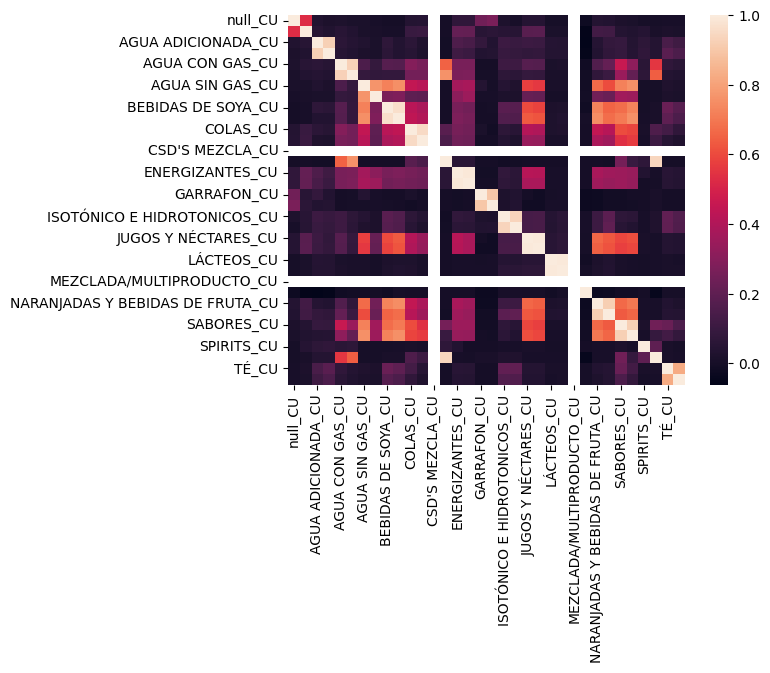

In [ ]:
sns.heatmap(df.corr());

In [ ]:
df.corr()

<ipython-input-105-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,null_CU,null_INGRESOBRUTO,AGUA ADICIONADA_CU,AGUA ADICIONADA_INGRESOBRUTO,AGUA CON GAS_CU,AGUA CON GAS_INGRESOBRUTO,AGUA SIN GAS_CU,AGUA SIN GAS_INGRESOBRUTO,BEBIDAS DE SOYA_CU,BEBIDAS DE SOYA_INGRESOBRUTO,...,MEZCLADA/MULTIPRODUCTO_CU,MEZCLADA/MULTIPRODUCTO_INGRESOBRUTO,NARANJADAS Y BEBIDAS DE FRUTA_CU,NARANJADAS Y BEBIDAS DE FRUTA_INGRESOBRUTO,SABORES_CU,SABORES_INGRESOBRUTO,SPIRITS_CU,SPIRITS_INGRESOBRUTO,TÉ_CU,TÉ_INGRESOBRUTO
null_CU,1.000000,0.530121,0.030289,0.019781,0.024324,0.014551,0.013770,0.008478,-0.000807,-0.002077,...,NaN,-0.021418,0.038026,0.035517,0.018133,0.016308,0.002446,0.003551,0.008395,0.005653
null_INGRESOBRUTO,0.530121,1.000000,0.049249,0.033439,0.054210,0.034139,0.017230,0.010732,0.006385,0.006003,...,NaN,-0.054843,0.121843,0.118705,0.039351,0.029714,0.046005,0.011796,0.021310,0.016392
AGUA ADICIONADA_CU,0.030289,0.049249,1.000000,0.922623,0.060927,0.044121,0.032641,0.016641,0.069263,0.036839,...,NaN,-0.061555,0.045617,0.083152,0.091301,0.041485,0.063713,0.040464,0.142816,0.114741
AGUA ADICIONADA_INGRESOBRUTO,0.019781,0.033439,0.922623,1.000000,0.049075,0.036930,0.018647,0.015953,0.060662,0.035869,...,NaN,-0.051995,0.037578,0.074680,0.087610,0.043769,0.072876,0.041248,0.184163,0.153863
AGUA CON GAS_CU,0.024324,0.054210,0.060927,0.049075,1.000000,0.926395,0.150699,0.085788,0.176240,0.174220,...,NaN,-0.013927,0.165418,0.213491,0.459666,0.316746,0.054839,0.555221,0.071635,0.055743
AGUA CON GAS_INGRESOBRUTO,0.014551,0.034139,0.044121,0.036930,0.926395,1.000000,0.087000,0.076112,0.081167,0.079479,...,NaN,-0.010541,0.072828,0.103465,0.346672,0.211355,0.064543,0.640896,0.041547,0.032947
AGUA SIN GAS_CU,0.013770,0.017230,0.032641,0.018647,0.150699,0.087000,1.000000,0.765233,0.720511,0.754586,...,NaN,-0.007785,0.669735,0.602278,0.721583,0.757825,0.002718,0.003241,0.026097,0.019547
AGUA SIN GAS_INGRESOBRUTO,0.008478,0.010732,0.016641,0.015953,0.085788,0.076112,0.765233,1.000000,0.268785,0.280999,...,NaN,-0.004795,0.249016,0.228111,0.362730,0.350203,0.002616,0.002274,0.019995,0.015036
BEBIDAS DE SOYA_CU,-0.000807,0.006385,0.069263,0.060662,0.176240,0.081167,0.720511,0.268785,1.000000,0.965338,...,NaN,-0.013470,0.725074,0.652481,0.673241,0.723206,0.002824,0.009355,0.227318,0.174890
BEBIDAS DE SOYA_INGRESOBRUTO,-0.002077,0.006003,0.036839,0.035869,0.174220,0.079479,0.754586,0.280999,0.965338,1.000000,...,NaN,0.001588,0.749716,0.672938,0.704046,0.756923,0.007179,0.010967,0.198799,0.153074


# Borrame


In [ ]:
query="""SELECT *,
CAST(MES AS INT) MES_,
CAST(CU AS DECIMAL(9,2)) CU_,
CAST(INGRESOBRUTO AS DECIMAL(9,2)) INGRESOBRUTO_,
CAST(VOL_ING_CIMPTOS AS DECIMAL(9,2)) VOL_ING_CIMPTOS_,
CAST(CF AS INT) CF_
FROM ventas;"""


In [ ]:
clientes_sp=spark.sql(query)

In [ ]:
from pyspark.sql import functions as F
df = ventas_sp.groupBy('KUNNR').pivot('CATEGORIA').agg(F.first('CU').alias('CU'),F.first('INGRESOBRUTO').alias('INGRESOBRUTO'))

ERROR:root:KeyboardInterrupt while sending command.
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/py4j/java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
  File "/usr/local/lib/python3.9/dist-packages/py4j/clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/usr/lib/python3.9/socket.py", line 704, in readinto
    return self._sock.recv_into(b)
KeyboardInterrupt


KeyboardInterrupt: ignored

In [ ]:
materiales_sp.show()

+---+------------------+--------------------+-----+
|_c0|             MATNR|               MAKTX|MVGR2|
+---+------------------+--------------------+-----+
|  0|000000000000000566|LFT PET 2LTNR 4 P...|  110|
|  1|000000000000000631|MEZFTA MND UVA MZ...|  110|
|  2|000000000000000899|COCA COLA 12 OZ L...|  100|
|  3|000000000000000901|CC PET BALL 400ML...|  100|
|  4|000000000000000971|12ESCA 12 OZ LATA...|  110|
|  5|000000000000000994|SPRITE LIGHT LATA...|  110|
|  6|000000000000001241|CLON FANTA MSB UV...|  110|
|  7|000000000000001262|MEZC FTA MAND-TUT...|  110|
|  8|000000000000001478|FANTA DURAZNO 2 L...|  110|
|  9|000000000000001801|CC ZERO COLA BOT ...|  100|
| 10|000000000000001823|FRESCAZERO 237MLM...|  110|
| 11|000000000000001857|YOLI LIMON BOT 2L...|  110|
| 12|000000000000001884|  CC BOT 500MLVR 1PK|  100|
| 13|000000000000002086|MEZCLA AMEYAL  2L NR|  110|
| 14|000000000000002615|Clon CC 235 ml la...|  100|
| 15|000000000000084151|CIEL JAM PLUS 250...|  220|
| 16|0000000